# Understanding Regularization
## Least Squares
Let say we are doing a physics experiment to determine the gravitational acceleration $g$ by the falling ball experiment. Now from physics we know that the equation of motion that governs this experiment is $$s=ut+\frac{1}{2}gt^2 \tag{1}$$ In an ideal world, when we drop the ball from a particular height $s$ and measure the time $t$ it takes to travel $s$, we will find that the $t$ s fit the equation. In practice however, it could be that due to errors in the experiment (random/systematic/human reaction time), the data we obtain may not exactly conform to $(1)$. Nonetheless, it is possible that we would like to use our measured data and fit a line through them (build a model).

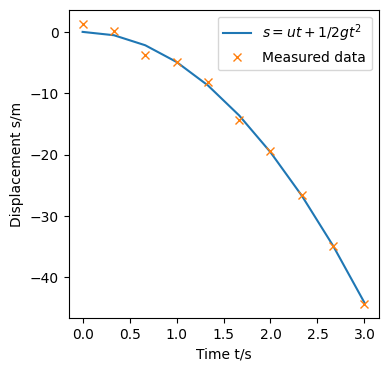

In [12]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import axes3d

np.random.seed(10)
t = np.linspace(0,3,10)
g = -9.81
u = 0

s = u*t + 0.5*g*t**2
fig, ax = plt.subplots(figsize=(4, 4))
ax.plot(t,s,label="$s=ut+1/2 gt^2$")
ax.plot(t,s+np.random.randn(len(t)),'x',label="Measured data")
ax.set_xlabel("Time t/s")
ax.set_ylabel("Displacement s/m")
ax.legend();


For our model, let $s_t$ be the true displacement data points that fits (1), $y_t$ the displacement results from our experiment (measured data). $y_t$ can be written as a linear combination of powers of time $y_t=w_0+w_1t+w_2t^2+...$, where $w_n$ are weights for each $t^n$ for $n=0,1,2...N$. If we define $\phi(t)$ as a vector function of $t$ s, $y_t$ can be written vectorially as $\bold{w}^T\phi(t)$. With our experiment, the weights are the parameters to be determined from our measured data. A good model will have $w_o\approx 0$, $w_1\approx 0$, $w_2\approx 0.5*9.81$ and all other weights = $0$. 

To determine the error $E_D$ between true data (target) and measured data, a common metric is to use the sum-of-squares error (SSE). $$SSE=\sum_{t=1}^{N}(s_t-y_t)^2$$ So when the all $y_t$ equals the $s_t$, i.e. our measurements match the true data, we get a SSE of zero. 

As a simple example, let $N=1, t=1, s_1=7, w_0=0, w_1\in\{-100...100\},w_2\in\{-100...100\}$. The plot below shows the sum-of-squares error for all $w_1,w_2$ pairs between -100 and 100.

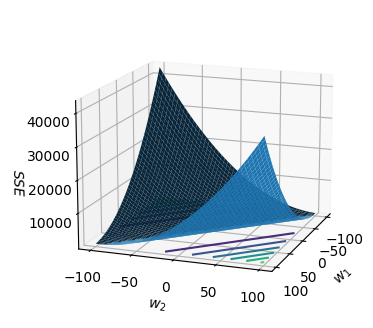

In [13]:
from mpl_toolkits.mplot3d import axes3d

# for simplicity, assume N=1, t=1, s_1=7, w_0=0
s_1 = 7
t = 1
w_1 = np.linspace(-100,100,200)
w_2 = np.linspace(-100,100,200)

[W_1, W_2] = np.meshgrid(w_1, w_2)
f = (s_1 - (W_1*t+W_2*t**2))**2 

ax = plt.figure(figsize=(4,4)).add_subplot(projection='3d')
ax.plot_surface(W_1,W_2,f)
ax.set_xlabel("$w_1$")
ax.set_ylabel("$w_2$")
ax.set_zlabel("$SSE$")
ax.contour(W_1,W_2,f,zdir='z',offset=0)
ax.view_init(elev=15, azim=20)



The contour lines for various SSE values (level sets) are plotted as coloured lines on the $w_1w_2$ plane.

More generally, the SSE between target and data can be written as $$E_D(\bold{w})=\frac{1}{2}\sum_{n=1}^{N}(t_n-y_n)^2$$ where $N$: Number of data points, $t_n$: target data, $y_n=\bold{w}^T\phi(\bold{x}_n)$: A linear combination of basis functions $\phi(x)$.

With the $E_D$ (loss function) defined, we may proceed to build a regression model. Quite often we find that with limited data, our model overfits. This is where regularization comes in. Regularization is a technique to combat overfitting.

## Regularized Least Squares 

### Regularized Error function

$$E_R(\bold{w})=\frac{1}{2}\sum_{n=1}^{N}(t_n-\bold{w}^T\phi(\bold{x}_n))^2+\lambda \bold{w}^T\bold{w} \tag{2}$$

The regularized error function consists of 2 terms - the error between target and data and the squared weights (L2 penalty function).

This is related to solving the constrained optimization problem

$$minimize\; \frac{1}{2}\sum_{n=1}^{N}(t_n-\bold{w}^T\phi(\bold{x}_n))^2 \\
subject\; to\; \bold{w}^T\bold{w}\le\eta
$$
where $\eta$ is a parameter. We can write the above problem in terms of the Lagrange function $$L(\bold{w},\lambda' ) = f(\bold{w}) + \lambda' g(\bold{w})$$ where $f(\bold{w}) = \frac{1}{2}\sum_{n=1}^{N}(t_n-\bold{w}^T\phi(\bold{x}_n))^2$, $g(\bold{w})=\bold{w}^T\bold{w}-\eta $. Minimizing $$L(\bold{w},\lambda' ) = \frac{1}{2}\sum_{n=1}^{N}(t_n-\bold{w}^T\phi(\bold{x}_n))^2  + \lambda'(\bold{w}^T\bold{w}-\eta) \tag{3}$$ is equivalent to minimizing $(2)$ if $\lambda'=\lambda$. To see this, when $\lambda'=\lambda$, notice that the lagrangian has an extra $-\lambda\eta$ constant term. The $\bold{w}$ that minimizes the lagrangian, $\bold{w}^*$ is the same solution as minimizing $(2)$ albeit with a $L(\bold{w}^*)$ value $\lambda\eta$ less than $E_R(\bold{w^*})$.

Let $\bold{w}$ be a weight vector consisting of 2 variables, $w_1, w_2$. Hence, $$\bold{w}^T\bold{w}=\begin{bmatrix}w_1 & w_2\end{bmatrix}\begin{bmatrix}w_1 \\ w_2\end{bmatrix}=w_1^2+w_2^2$$ The figure below shows a plot of $w_1$ vs $w_2$ with $\eta=1$ and $\eta=4$. 


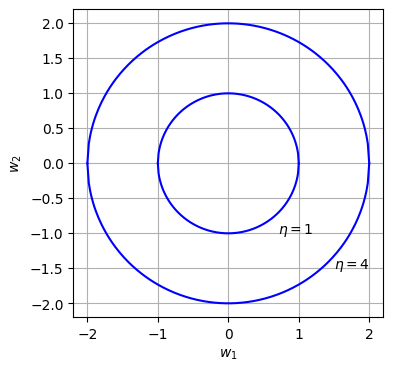

In [14]:
#set weight order
q = 2

#plotting constraint with eta=1
eta = 1
fig, ax = plt.subplots(figsize=(4, 4))
w1 = np.linspace(-1,1,201)
w2 = np.power(eta - np.power(np.abs(w1),q), 1/q)
ax.plot(w1,w2,color='b')
ax.plot(w1,-w2,color='b')
ax.annotate(xy=(0.7,-1),text=r'$\eta=1$')

#plotting constraint with eta=4
eta = 4
w1 = np.linspace(-2,2,201)
w2 = np.power(eta - np.power(np.abs(w1),q), 1/q)
ax.plot(w1,w2,color='b')
ax.plot(w1,-w2,color='b')
ax.annotate(xy=(1.5,-1.5),text=r'$\eta=4$')
ax.set_xlabel(r'$w_1$')
ax.set_ylabel(r'$w_2$');
ax.grid()

The internal area of each circle represents the set of $w_1,w_2$ that satisfies the constraint (inequality) $\bold{w}^T\bold{w}\le\eta$. 

To understand how the constraint function affects the weight parameters, let us illustrate with an example. Let say our target line is $y=6x + x^2$. 3 true $x$, $x^2$ points are $[4,16],[1,1],[7,49]$. And let say our measured data are $[2,7],[1,5],[6,10]$. The code below illustrates our example.

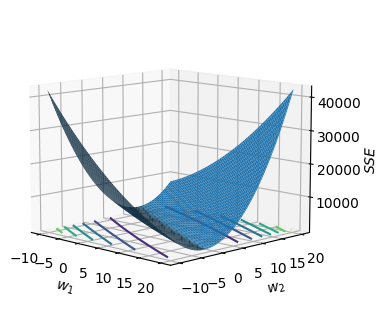

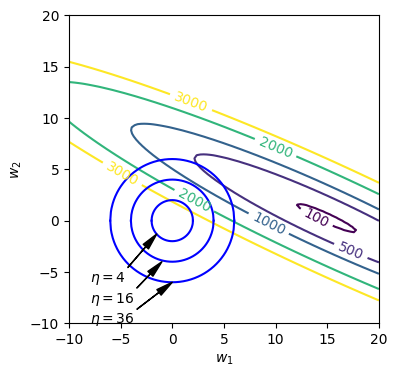

In [15]:
# target line y=6x+x^2
target = np.array([[4,16],[1,1],[7,49]])
x = np.linspace(-10,20,100)
y = np.linspace(-10,20,100)

[W1, W2] = np.meshgrid(x, y)
d = np.array([[2,7],[1,5],[6,10]]).T

m = np.matmul(np.concatenate((W1.reshape(-1,1),W2.reshape(-1,1)),axis=1),d)
diff = (np.matmul(np.array([6,1]),target.T)-m)
f = 0.5*(np.sum(np.square(diff),axis=1).reshape(W1.shape[0],-1))

# Plotting 3D SSE 
ax = plt.figure(figsize=(4,4)).add_subplot(projection='3d')
ax.plot_surface(W1,W2,f)
ax.set_xlabel(r'$w_1$')
ax.set_ylabel(r'$w_2$')
ax.set_zlabel(r'$SSE$')
ax.contour(W1,W2,f,zdir='z',offset=0)
ax.view_init(elev=10, azim=-45)
plt.show()

#From graph, min located approx at (15,1)
fig, ax = plt.subplots(figsize=(4,4))
cp = ax.contour(W1,W2,f,levels=[100,500,1000,2000,3000])
ax.clabel(cp, cp.levels)

#plotting constraint curves for eta = 4,16,36
eta = 4
w1 = np.linspace(-2,2,201)
w2 = np.power(eta - np.power(np.abs(w1),q), 1/q)
ax.plot(w1,w2,color='b')
ax.plot(w1,-w2,color='b')
ax.annotate(xy=(-1.5,-1.3),xytext=(-8,-6),arrowprops=dict(facecolor='black', 
                                                     shrink=1, 
                                                     width=0.1,
                                                     headwidth=5),
                                                     text=r'$\eta=4$')

eta = 16
w1 = np.linspace(-4,4,201)
w2 = np.power(eta - np.power(np.abs(w1),q), 1/q)
ax.plot(w1,w2,color='b')
ax.plot(w1,-w2,color='b')
ax.annotate(xy=(-1,-4),xytext=(-8,-8),arrowprops=dict(facecolor='black', 
                                                     shrink=1, 
                                                     width=0.1,
                                                     headwidth=5),
                                                     text=r'$\eta=16$')

eta = 36
w1 = np.linspace(-6,6,201)
w2 = np.power(eta - np.power(np.abs(w1),q), 1/q)
ax.plot(w1,w2,color='b')
ax.plot(w1,-w2,color='b')
ax.annotate(xy=(0,-6),xytext=(-8,-10),arrowprops=dict(facecolor='black', 
                                                     shrink=1, 
                                                     width=0.1,
                                                     headwidth=5),
                                                     text=r'$\eta=36$')

ax.set_xlabel(r'$w_1$')
ax.set_ylabel(r'$w_2$')
plt.show()




The blue surface shows the unregularized error function. Next, we superimpose the constraint curves on the unregularized error function contour plot as shown in the figure above. The coloured contour lines are the level sets for the unregularized error function while the dark blue circular plots are the constraint curves for $\eta = 4,16,36$. From the contour plot, we observe that
1. The minimum point for the unregularized error function at approximately at (15,1).
2. With $\eta=36$, the constraint curve intersects the contour at about 500. i.e. the constraint curve 'pulls' the minimum point towards the left of the $w_1w_2$ plane as only points within the circle are valid (points that satisfies $\bold{w}^T\bold{w}\le 36$). 
3. With $\eta=4$, the constraint curve intersects the contour at about 3000. So as we decrease $\eta$, the loss value increases but the magnitude of $w_1$ and $w_2$ decreases: (2,2). 
  
From the above observation, we can see that when we set a constraint that the magnitude of $\bold{w}$ be small, the solution we find will tend to have a smaller magnitude than that of the unregularized error function. 

Now with these insights, let us return to $(2)$. While the lagrangian is similar to $(2)$, in machine learning context, the second term in (1) is usually referred to as the penalty function. The regularization coefficient $\lambda$ is usually a hyperparameter set by experimentation. This $\lambda$ factor is something like a weight. For $\lambda = 0$, the is no regularization applied. For a small $\lambda$ the penalty function has a small overall effect on the overall loss function, $E_R(\bold{w})$. For a large $\lambda$ we are enforcing that the penalty function is an important factor to minimize i.e. the weights should be small. Due to this property, it is also known as weight decay in machine learning literature. Regularization reduces overfitting as it encourages smaller coefficients. For instance, fitting a straight line $w_0+w_1x+w_2x^2+...$, we would expect that the weights of the higher order terms to be close to zero. If the model overfits, we would have non-zero coefficients for the higher powers. e.g. instead of drawing a straight line, we can have a quadratic/cubic curve passing through all points. 

### Example: Regularization in action 
Let us say that we are trying to fit a quadratic curve $f(x)=7+x+3x^2$. For simplicity, we are given only 6 $x$ points:$ -3, -1, 2, 3, 5, 7$. Let us model the data using a 4th order polynomial - $w_0+w_1x+w_1x^2+w_3x^3+w_4x^4 = \bold{w}^T\phi(x)$, where $\phi(x)=\begin{bmatrix}1 \\ x \\ x^2 \\ x^3 \\ x^4\end{bmatrix}$,  $\bold{w}=\begin{bmatrix}w_0 \\ w_1 \\ w_2 \\ w_3 \\ w_4\end{bmatrix}$. Let us set the regularization coefficient $\lambda = 5$ and initialize $\bold{w}=\begin{bmatrix}10 \\ 10 \\ 10 \\ 10 \\ 9\end{bmatrix}$. With these values, we can compute the loss function $(2)$.

In [16]:
x = np.array([-3,-1,2,3,5,7])  #initialize x 
w = np.array([10,10,10,10,9])  #initialize weight
lamb = 5 #regularization coefficient

To find the $\bold{w}$ that minimizes the loss function $(2)$, we use stochastic gradient descent (SGD). 
Gradient of (2):
$\nabla{E_R(\bold{w})}=-(f(x)-\bold{w}^T\phi(x))\phi(x)+2\lambda \bold{w}$

The update step:
$\bold{w^{i+1}}=\bold{w^i}-\frac{\alpha}{N} \nabla{E_R(\bold{w})}$

Learning rate: $\alpha = 10^{-6}$ (Note: Hyperparameter set by experimenting various values.)

Number of samples: $N$

Number of iterations: $100,000$

In [17]:
# SGD to obtain weights
alpha = 0.000001 #learning rate
for iter in range(100000):
    L = 0 #initialize loss
    for x_i in x:
        phi_x = np.array([1, x_i, x_i**2, x_i**3,x_i**4])
        weighted_s = np.matmul(w,phi_x)
        L += 0.5*(7+x_i+3*x_i**2-weighted_s)**2 + lamb*np.sum(w.T*w) #Loss function
        dL = -phi_x*(7+x_i+3*x_i**2-weighted_s) + lamb*2*w #Gradient of loss
        w = w-alpha*(dL)/len(x)  #Update step
    
    print("Loss:",L)
    print (w)

Loss: 303623094.36259633
[ 9.99448074  9.96611143  9.77533378  8.50189486 -1.19191946]
Loss: 275442.79869169806
[ 9.99423525  9.96490799  9.77046832  8.47021594 -1.37307123]
Loss: 175478.4790080185
[ 9.99408388  9.96428809  9.76952556  8.4647084  -1.37557826]
Loss: 175222.27862535298
[ 9.9939342   9.96367886  9.76865308  8.45967046 -1.37489769]
Loss: 175053.9636578567
[ 9.99378456  9.96307008  9.76778214  8.45464348 -1.37416061]
Loss: 174886.84604381496
[ 9.99363494  9.96246155  9.76691151  8.44961926 -1.3734229 ]
Loss: 174719.91759985476
[ 9.99348533  9.96185329  9.76604116  8.44459765 -1.37268554]
Loss: 174553.16034113764
[ 9.99333573  9.96124529  9.76517111  8.43957866 -1.37194857]
Loss: 174386.57377416446
[ 9.99318615  9.96063755  9.76430134  8.43456228 -1.37121198]
Loss: 174220.15771755844
[ 9.99303658  9.96003007  9.76343185  8.42954851 -1.37047577]
Loss: 174053.91199568837
[ 9.99288702  9.95942285  9.76256265  8.42453734 -1.36973993]
Loss: 173887.8364332026
[ 9.99273748  9.95881

Putting it all together, we have

In [18]:
# Example of regularization vs no regularization
x = np.array([-3,-1,2,3,5,7])  #initialize x 
w = np.array([10,10,10,10,9])  #initialize weights
alpha = 0.000001 #learning rate
lamb = 5 #regularization coefficient

# SGD to obtain weights
for iter in range(100000):
    L = 0 #initialize loss
    for x_i in x:
        phi_x = np.array([1, x_i, x_i**2, x_i**3,x_i**4])
        weighted_s = np.matmul(w,phi_x)
        L += 0.5*(7+x_i+3*x_i**2-weighted_s)**2 + lamb*np.sum(w.T*w) #Loss function
        dL = -phi_x*(7+x_i+3*x_i**2-weighted_s) + lamb*2*w #Gradient of loss
        w = w-alpha*(dL)/len(x)  #Update step
    
    print("Loss:",L)
    print (w)


#Results
#no regularization: lamb = 0 
#after 100,000 iterations
#Loss: 113.81919356847847
#[ 9.14084877  8.18992779  2.46073974 -0.65050656  0.08209003]


#with regularization: lamb = 5 
#after 100,000 iterations
#Loss: 954.2707341632134
#[ 3.58727023  3.14255901  2.5549417  -0.1588695   0.02697015]

Loss: 303623094.36259633
[ 9.99448074  9.96611143  9.77533378  8.50189486 -1.19191946]
Loss: 275442.79869169806
[ 9.99423525  9.96490799  9.77046832  8.47021594 -1.37307123]
Loss: 175478.4790080185
[ 9.99408388  9.96428809  9.76952556  8.4647084  -1.37557826]
Loss: 175222.27862535298
[ 9.9939342   9.96367886  9.76865308  8.45967046 -1.37489769]
Loss: 175053.9636578567
[ 9.99378456  9.96307008  9.76778214  8.45464348 -1.37416061]
Loss: 174886.84604381496
[ 9.99363494  9.96246155  9.76691151  8.44961926 -1.3734229 ]
Loss: 174719.91759985476
[ 9.99348533  9.96185329  9.76604116  8.44459765 -1.37268554]
Loss: 174553.16034113764
[ 9.99333573  9.96124529  9.76517111  8.43957866 -1.37194857]
Loss: 174386.57377416446
[ 9.99318615  9.96063755  9.76430134  8.43456228 -1.37121198]
Loss: 174220.15771755844
[ 9.99303658  9.96003007  9.76343185  8.42954851 -1.37047577]
Loss: 174053.91199568837
[ 9.99288702  9.95942285  9.76256265  8.42453734 -1.36973993]
Loss: 173887.8364332026
[ 9.99273748  9.95881

Loss: 147015.54036466312
[ 9.96646854  9.85535219  9.61227881  7.5728393  -1.24462251]
Loss: 146877.12480119808
[ 9.96632123  9.8547894   9.61145871  7.56827392 -1.24395153]
Loss: 146738.8507503943
[ 9.96617394  9.85422684  9.61063887  7.56371092 -1.24328089]
Loss: 146600.71806660268
[ 9.96602665  9.85366452  9.6098193   7.55915029 -1.2426106 ]
Loss: 146462.7266043239
[ 9.96587938  9.85310243  9.60899999  7.55459204 -1.24194065]
Loss: 146324.87621820872
[ 9.96573213  9.85254059  9.60818094  7.55003616 -1.24127105]
Loss: 146187.1667630579
[ 9.96558488  9.85197898  9.60736215  7.54548265 -1.24060179]
Loss: 146049.59809382146
[ 9.96543764  9.8514176   9.60654362  7.54093151 -1.23993288]
Loss: 145912.170065599
[ 9.96529042  9.85085646  9.60572536  7.53638274 -1.23926431]
Loss: 145774.88253363958
[ 9.96514321  9.85029556  9.60490736  7.53183633 -1.23859609]
Loss: 145637.73535334124
[ 9.96499601  9.84973489  9.60408962  7.5272923  -1.23792821]
Loss: 145500.7283802511
[ 9.96484883  9.84917446

Results:

After 100,000 iterations
|  | Loss | w |
| ---- |  --- | --- |
| No regularization: $\lambda = 0$ |  113.8 | [ 9.14084877  8.18992779  2.46073974 -0.65050656  0.08209003] |
| With regularization: $\lambda = 5$ | 954.3 | [ 3.58727023  3.14255901  2.5549417  -0.1588695   0.02697015] |

We can see from the above table that regularization results in smaller coefficients. The penalty function penalizes large weight values and results in smaller coefficents. We can see that the 3rd and 4th order coefficients are driven close to 0 in the regularized case. 

Let us plot the graphs for the actual line, unregularized and regularized case.

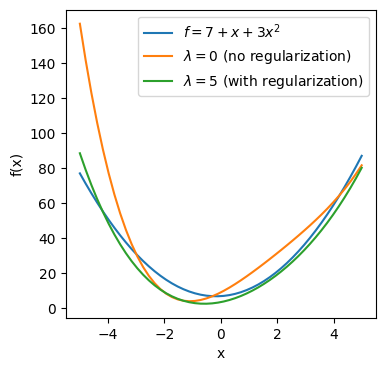

In [19]:
#Plotting $f=7+x+3x^2$, with lambda=0, lambda=5 
x = np.linspace(-5,5,50)
fig, ax = plt.subplots(figsize=(4, 4))
f = 7+x+3*x**2
ax.plot(x,f,label="$f=7+x+3x^2$")
ax.plot(x, 9.14084877+8.18992779*x+2.46073974*x**2-0.65050656*x**3+0.08209003*x**4,label="$\lambda=0$ (no regularization)")
ax.plot(x, 3.58727023+3.14255901*x+2.5549417*x**2-0.1588695*x**3+0.02697015*x**4,label="$\lambda=5$ (with regularization)")
ax.set_xlabel("x")
ax.set_ylabel("f(x)")
ax.legend();

From the above plot, the green line ($\lambda=5$) is closer to the actual line $f$ (blue) than the orange line ($\lambda=0$) which we are trying to learn. 

## L1 regularization
The other penalty function commonly used is the L1 norm. So instead of penalizing the squared weights (L2 norm), we penalize the L1 norm of the weights. So instead of (2), we have

$$E_R(\bold{w})=\frac{1}{2}\sum_{n=1}^{N}(t_n-\bold{w}^T\phi(\bold{x}_n))^2+\lambda |\bold{w}| \tag{4}$$

The L1 regularizer tend to produce sparse solutions i.e. more coefficients are driven to zero. To see this, compare the quadratic function and absolute valued function.

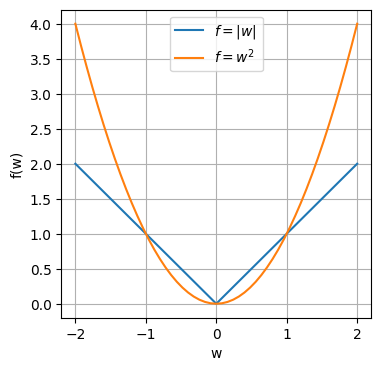

In [20]:
# Plotting the quadratic function and absolute valued function
w = np.linspace(-2,2,51)
fig, ax = plt.subplots(figsize=(4, 4))
ax.plot(w,np.absolute(w),label="$f=|w|$")
ax.plot(w, np.square(w),label="$f=w^2$")
ax.set_xlabel("w")
ax.set_ylabel("f(w)")
ax.grid()
ax.legend();

Looking at the graph, in the range $-1 < w < 1$, for the L1 norm, the gradient is still a constant, whereas with the L2 norm, the gradient decreases with every step moving closer to zero. So when we do gradient descent, L1 will take a constant step forward in every iteration towards 0. With L2 norm, as the gradient decreases as we move to 0, each step size gets smaller and smaller with each iteration. The following table 
compares the $w$ for 10 iterations of gradient descent for $f_{L1}(w)=|w|$, $f_{L2}(w)=w^2$ with step $s = 0.1$. 

| Iteration | $\nabla f(w)=1$,  $w^{i+1} = w^{i} - s$   | $\nabla f(w)= 2w$, $w^{i+1} = w^{i} - 2sw^{i}$  |
| --- | --- | ---|
| 0 | $w = 1$ | $w=1$ |
| 1 | $w = 0.9$ | $w = 0.8$ |
| 2 | $w = 0.8$ | $w = 0.8-0.2(0.8)=0.64$ |
| 3 | $w = 0.7$ | $w = 0.64-0.2(0.64)=0.512$ |
| | ... | ... |
|10|$w = 0$ | $w = 0.1073741824$ |

In [21]:
#Computing the w values for L1 & L2 
def recursel1(w,s):
    return w - s

def recursel2(w,s):
    return w - s*w

l_1 = [1]  #initialize w = 1 at iteration 0
l_2 = [1]  #initialize w = 1 at iteration 0

#L1 iteration
w = 1
for iter in range(10):
    w = recursel1(w, 0.1)
    l_1.append(w)

#L2 iteration
w = 1
for iter in range(10):
    w = recursel2(w, 0.2)
    l_2.append(w)


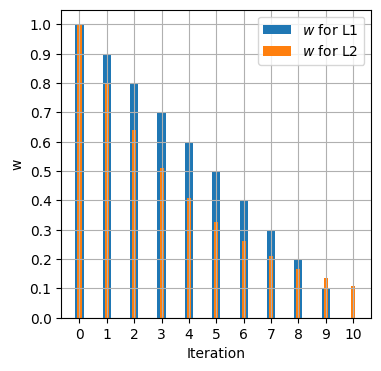

In [22]:
# Plotting the w values for L1 & L2 for 10 iterations
w = np.linspace(0,1.5,51)
x = np.linspace(0,10,11)
fig, ax = plt.subplots(figsize=(4, 4))

ax.bar(x,l_1,width=0.3,label="$w$ for L1")
ax.bar(x,l_2,width=0.15,label="$w$ for L2")
ax.set_xlabel("Iteration")
ax.set_ylabel("w")
ax.set_xticks(np.arange(0,11))
ax.set_yticks(np.arange(0,1.1,0.1))
ax.grid(True)
ax.legend();

As the graph above indicates, the L1 norm has $w$ driven to 0 at iteration 10, whereas with L2, the closer we get to 0, the slower the decrease in $w$ as the step reduction gets smaller with each iteration.

## References 
1. Christopher M. Bishop. Pattern Recognition and. Machine Learning
2. https://www.cs.toronto.edu/~rgrosse/courses/csc411_f18/slides/lec06-slides.pdf 